# Visual comparison of GRU v.s. IrregGRU predictions

In [1]:
%matplotlib inline
import matplotlib.pyplot as plt
from matplotlib_scalebar.scalebar import ScaleBar
import os
import rasterio
from rasterio.windows import Window
import numpy as np

proj_dir = os.path.dirname(os.getcwd())
exp_dir = os.path.join(proj_dir, 'output')


In [2]:
alpha = 0.8

red = np.array([234, 32, 39, 255 * alpha]) / 255
yellow = np.array([255, 195, 18, 255 * alpha]) / 255
gray = np.array([100, 100, 100, 255 * alpha]) / 255
pink = np.array([253, 167, 223, 255 * alpha]) / 255

colormap_pred = np.zeros((256, 4))
colormap_pred[1] = yellow
colormap_pred[-1] = gray

colormap_diff = np.zeros((256, 4))
colormap_diff[1] = pink

patch_size = 250
fig_scale = 5

In [ ]:
gru_exp_name = 'GRU7df_bwrd_freeze0_lrfe1em06_lrtemp0_0001_tlossCE_asymgraddot_ltemp1_0_1_0_rs0'
irreggru_exp_name = 'NIrregGRU7df_bwrd_freeze0_lrfe1em06_lrtemp0_0001_tlossCE_asymgraddot_ltemp1_0_1_0_rs1'
exp_name_list = [gru_exp_name, irreggru_exp_name]
exp_short_name_list = ['ConvGRU', 'IrregConvGRU']
set = 'test'

input_dir = os.path.join(os.path.dirname(os.path.dirname(proj_dir)), 'Data', 'SwissImage')

dir_list = [os.path.join(exp_dir, exp_name, 'inference', 'epoch_39', set) for exp_name in exp_name_list]

In [ ]:
def hide_axis(ax):
    ax.set_xticks([])
    ax.set_yticks([])
    ax.spines['bottom'].set_color((0.0,)*4)
    ax.spines['top'].set_color((0.0,)*4) 
    ax.spines['right'].set_color((0.0,)*4)
    ax.spines['left'].set_color((0.0,)*4)

In [16]:
def plot_results(tk,               
                 year,
                 n_previous,
                 n_next,
                 x_start=0,
                 y_start=0,
                 skip_next=None,
                 fn_suffix=None):
    
    for i in range(len(exp_name_list)):
        # read prediction
        im_fn = os.path.join(dir_list[i], 'predictions_{}_{}.tif'.format(year, tk))
        with rasterio.open(im_fn, 'r') as f:
            im = f.read(1, window=Window(x_start, y_start, patch_size, patch_size))
            
        pred_im_list = [im]
        year_list = [year]
            
        # look for next prediction(s)
        if skip_next is None:
            skip_next = [False] * n_next
        count = 0
        skip_count = 0
        year_next = year + 1
        while count < n_next and year_next <= 2020:
            im_next_fn = os.path.join(dir_list[i], 'predictions_{}_{}.tif'.format(year_next, tk))
            if os.path.isfile(im_next_fn):
                if skip_next[count]:
                    pred_im_list.append(np.empty_like(im))
                    year_list.append(None)
                    skip_count += 1
                else:
                    with rasterio.open(im_next_fn, 'r') as f_next:
                        pred_im_list.append(f_next.read(1, window=Window(x_start, y_start, patch_size, patch_size)))
                        year_list.append(year_next) 
                count += 1
            year_next += 1
        
        # look for previous prediction(s)
        count = 0
        year_previous = year - 1
        while count < n_previous and year_previous >= 1946:
            im_previous_fn = os.path.join(dir_list[i], 'predictions_{}_{}.tif'.format(year_previous, tk))
            if os.path.isfile(im_previous_fn):
                with rasterio.open(im_previous_fn, 'r') as f_previous:
                    pred_im_list = [f_previous.read(1, window=Window(x_start, y_start, patch_size, patch_size))] + pred_im_list
                    year_list = [year_previous] + year_list
                    count += 1
            year_previous -= 1
        
        
        if i == 0:
            # read input images
            input_im_list = []
            for y in year_list:
                if y is None:
                    input_im_list.append(None)
                else:
                    input_fn = os.path.join(input_dir, str(y), '100cm', 'DOP100_LV95_{}_{}.tif'.format(tk, y))
                    with rasterio.open(input_fn, 'r') as f_input:
                        input_im_list.append(np.moveaxis(f_input.read(window=Window(x_start, y_start, patch_size, patch_size)),
                                                         (0, 1, 2), 
                                                         (2, 0, 1)))
            nrows = 2 + len(exp_name_list)
            n_years = len(year_list)
            ncols = n_years - int(skip_count > 0) * (skip_count - 1)
            width_ratios = [1] * ncols
            if skip_count > 0:
                skip_idx = np.min([idx for idx, val in enumerate(skip_next) if val]) + 1 + n_previous
                width_ratios[skip_idx] = 0.1
            _, ax = plt.subplots(nrows=nrows, 
                                   ncols=ncols, 
                                   figsize=(fig_scale*np.sum(np.array(width_ratios)), fig_scale*nrows),
                                   gridspec_kw={'width_ratios': width_ratios})
            ax[i, 0].set_ylabel('aerial image', rotation=90, size=42)
            current_col = 0
            for j, (input_im, pred_im, y) in enumerate(zip(input_im_list, pred_im_list, year_list)):
                hide_axis(ax[i, current_col])
                if j == len(year_list) - 1:
                    scalebar = ScaleBar(1.0,
                                        length_fraction=0.5,
                                        font_properties={"size": 36})
                    ax[i, current_col].add_artist(scalebar)
                if y is None:
                    if year_list[j-1] is not None:
                        ax[i, current_col].text(0.5, 0.5, '...', 
                                                fontsize=42, 
                                                ha='center')
                        current_col += 1
                else:
                    cmap='gray' if input_im.shape[-1] == 1 else None
                    ax[i, current_col].imshow(input_im, cmap=cmap)
                    ax[i, current_col].set_title(str(y), size=42)
                    current_col += 1
                
                
            
  
            pred_im_arr = np.empty((len(exp_name_list), n_years, *pred_im_list[0].shape))
            
        # plot predictions
        ax[i+1, 0].set_ylabel('prediction\n{}'.format(exp_short_name_list[i]), rotation=90, size=42)
        current_col = 0
        for j, (input_im, pred_im, y) in enumerate(zip(input_im_list, pred_im_list, year_list)):
            hide_axis(ax[i+1, current_col])
            if y is None:
                if year_list[j-1] is not None:
                    ax[i+1, current_col].text(0.5, 0.5, '...', 
                                              fontsize=42, 
                                              ha='center')
                    current_col += 1
            else:
                cmap='gray' if input_im.shape[-1] == 1 else None
                ax[i+1, current_col].imshow(input_im, cmap=cmap)
                ax[i+1, current_col].imshow(colormap_pred[pred_im])
                current_col += 1
        
        # fill array of all predictions for all experiments
        pred_im_arr[i] = np.array(pred_im_list)
        
    # plot prediction difference
    pred_im_diff_arr = (pred_im_arr[-1] != pred_im_arr[-2]).astype(int)
    ax[-1, 0].set_ylabel('prediction\ndifference', rotation=90, size=42)
    current_col = 0
    for j, (input_im, pred_im, y) in enumerate(zip(input_im_list, pred_im_list, year_list)):
        hide_axis(ax[-1, current_col])
        if y is None:
            if year_list[j-1] is not None:
                ax[-1, current_col].text(0.5, 0.5, '...', 
                                         fontsize=42, 
                                         ha='center')
                current_col += 1
        else:
            cmap='gray' if input_im.shape[-1] == 1 else None
            ax[-1, current_col].imshow(input_im, cmap=cmap)
            ax[-1, current_col].imshow(colormap_diff[pred_im_diff_arr[j]])
            current_col += 1
    plt.tight_layout()
    plt.savefig('GRU_vs_IrregGRU_{}.pdf'.format(tk if fn_suffix is None else fn_suffix))
    plt.show()
    

# Shadow

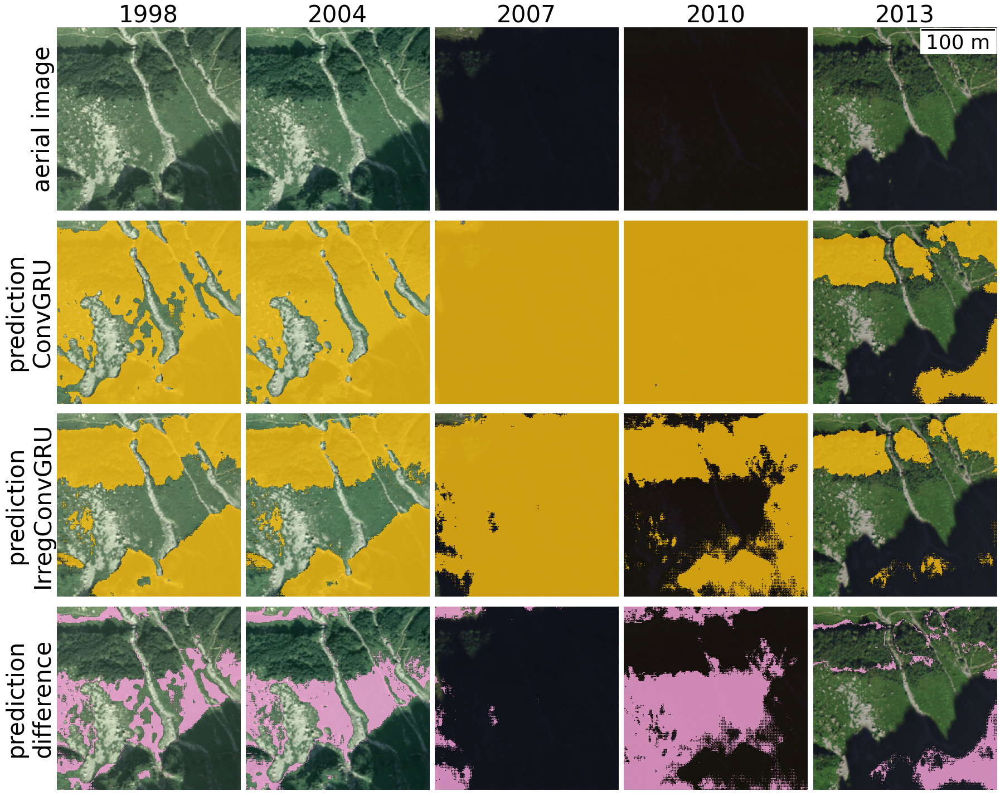

In [17]:
tk = '2554_1110'
year = 2007
n_previous = 2
n_next = 2

x_start = 500
y_start = 100

plot_results(tk=tk,               
             year=year,               
             n_previous=n_previous,               
             n_next=n_next,               
             x_start=x_start,               
             y_start=y_start,
             fn_suffix='shadow')
    

# Forest loss

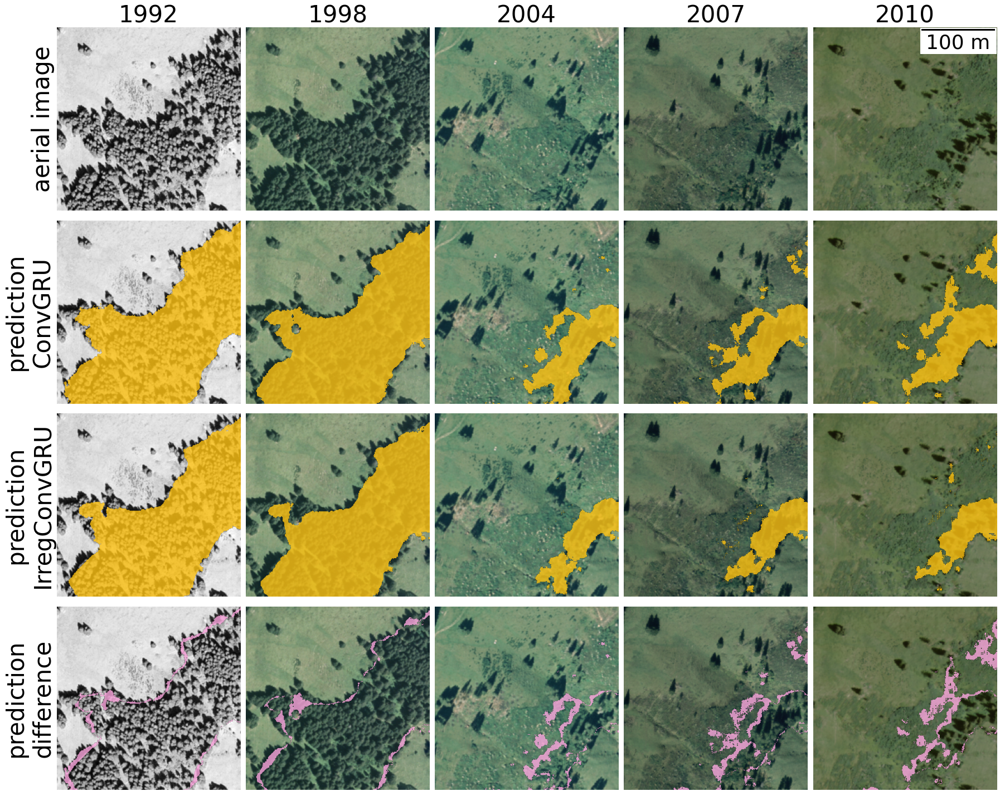

In [18]:
tk = '2584_1152'
year = 2004
n_previous = 2
n_next = 2

x_start = 450
y_start = 420

plot_results(tk=tk,               
             year=year,               
             n_previous=n_previous,               
             n_next=n_next,               
             x_start=x_start,               
             y_start=y_start,
             fn_suffix='floss')

# In-filling

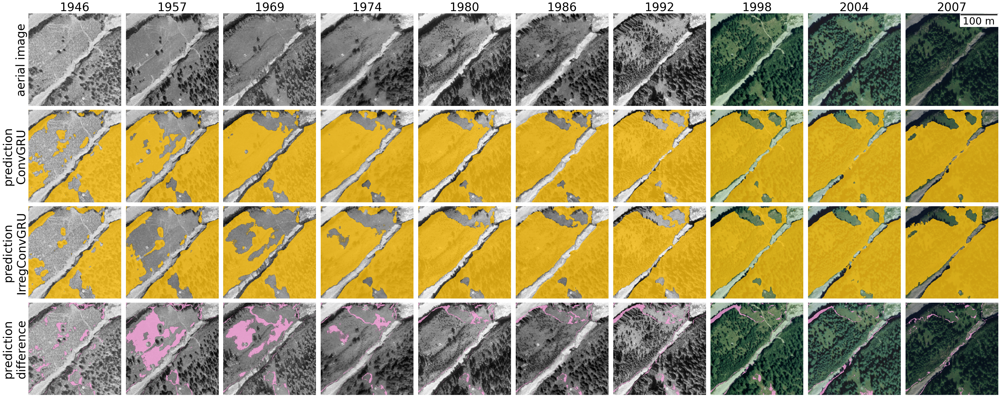

In [19]:
tk = '2584_1121'
year = 1974
n_previous = 3
n_next = 6

x_start = 10
y_start = 200

plot_results(tk=tk,               
             year=year,               
             n_previous=n_previous,               
             n_next=n_next,               
             x_start=x_start,               
             y_start=y_start)

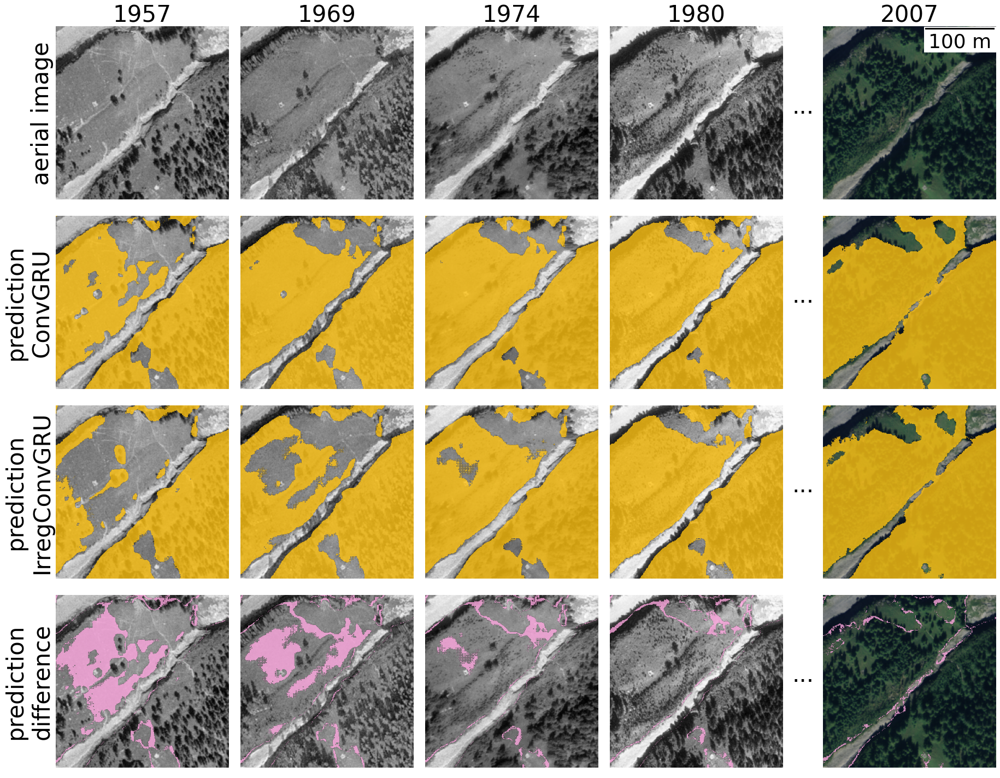

In [20]:
tk = '2584_1121'
year = 1974
n_previous = 2
n_next = 6
skip_next = [False, True, True, True, True, False] 

x_start = 10
y_start = 200

plot_results(tk=tk, 
             year=year, 
             n_previous=n_previous, 
             n_next=n_next, 
             skip_next=skip_next,
             x_start=x_start, 
             y_start=y_start,
             fn_suffix='infilling')

# In-filling + image quality

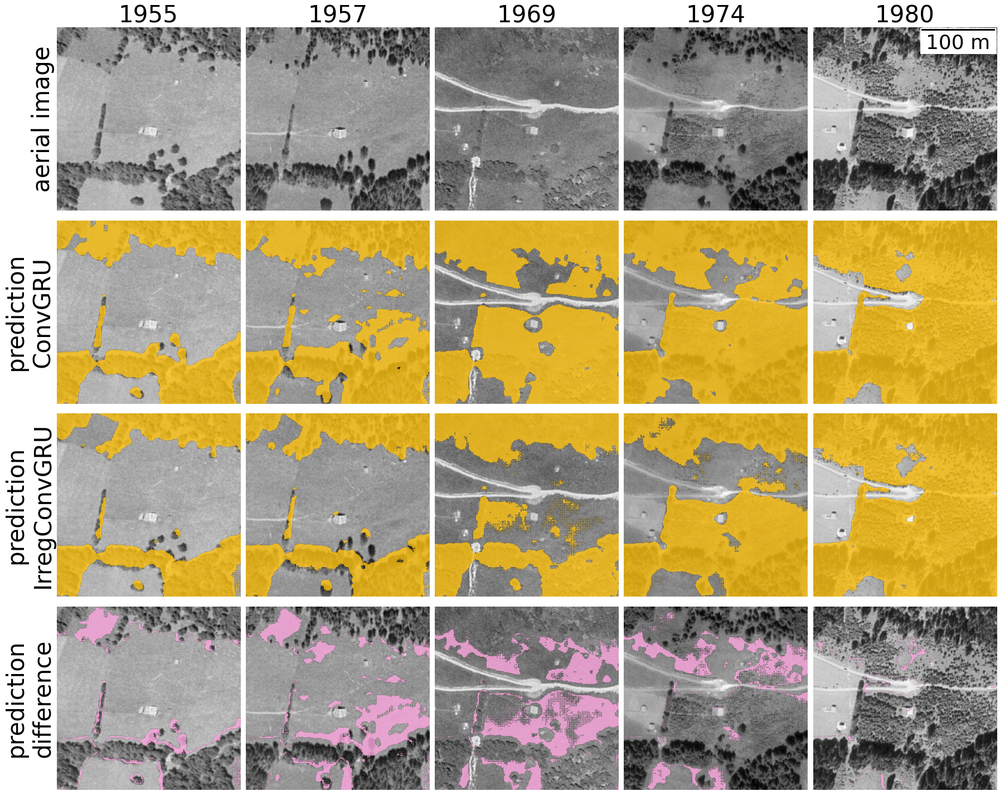

In [21]:
tk = '2554_1112'
year = 1969
n_previous = 2
n_next = 2

x_start = 100
y_start = 180

plot_results(tk=tk,               
             year=year,               
             n_previous=n_previous,               
             n_next=n_next,               
             x_start=x_start,               
             y_start=y_start,
             fn_suffix='imqual')

